In [1]:
# Импортируем библиотеки
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tqdm import tqdm_notebook
from sklearn.decomposition import PCA
import seaborn as sns
import plotly.graph_objs as go
import umap.umap_ as umap

In [2]:
from tensorflow.keras.datasets import mnist #загрузим набор данных MNIST, который содержит изображения рукописных цифр и соответствующие им метки.

In [6]:
# Функция для преобразования РСА
def make_PCA(dataframe, n=2):
    converter_pca = PCA(n_components=n, random_state=42)
    return converter_pca.fit_transform(dataframe)

In [58]:
# функция для выводя двумерных графиков без кластеризации
def make_simple_2D_plot(dataframe,  plot_name='*******', xaxis=0, yaxis=1):
    sns.set(rc={"figure.figsize":( 15, 8 )})
    fig = sns.scatterplot(x=dataframe[:,xaxis], y=dataframe[:,yaxis]).set(title=plot_name)
    return fig

In [39]:
# Функция для преобразования UMAP
def make_UMAP(dataframe, n=2):
    converter_umap = umap.UMAP(n_components=n,random_state=42)
    return converter_umap.fit_transform(dataframe)

In [17]:
# Функция для вывода цветов в зависимости от кластера
def Data_Color(i):
    if (i == 0):
        return "white"
    elif (i == 7):
        return "red"
    elif (i == 1):
        return "blue"
    elif (i == 2):
        return "pink"
    elif (i == 3):
        return "green"
    elif (i == 4):
        return "yellow"
    elif (i == 5):
        return "orange"
    elif (i == 6):
        return "purple"
    elif (i == 8):
        return "violet"
    elif (i == 9):
        return "magenta"

def make_2D_plot(dataframe, plot_name='*******', n=2):
    plt.style.use('dark_background')
    # Извлекаем данные из датафрейма
    data = dataframe.values

    # Создаем массив меток цвета
    df_labels = dataframe.index.values

    # Создаем массив цветов для каждой метки кластера
    cluster_colors = list(map(Data_Color, y_train_df['y_train']))

    # Создаем пустой фигурный холст
    fig, ax = plt.subplots()

    # Добавляем точки на график
    ax.scatter(data[:, 0], data[:, 1], c=cluster_colors, alpha=0.9)

    # Добавляем легенду и задаем название графика
    ax.set_title(plot_name)

    # Отображаем график
    plt.show()

In [21]:
# функция для выводя трёхмерных графиков с кластеризацией
def Data_Color(i):
    if (i == 0):
        return "white"
    elif (i == 7):
        return "red"
    elif (i == 1):
        return "blue"
    elif (i == 2):
        return "pink"
    elif (i == 3):
        return "green"
    elif (i == 4):
        return "yellow"
    elif (i == 5):
        return "orange"
    elif (i == 6):
        return "purple"
    elif (i == 8):
        return "violet"
    elif (i == 9):
        return "magenta"

def make_3D_plot(dataframe, plot_name='*******', n=2):

    data = dataframe
    fig = go.Scatter3d(x=data[:, 0],
                       y=data[:, 1],
                       z=data[:, 2],
                       marker=dict(opacity=0.9,
                                   reversescale=True,
                                   color=list(map(Data_Color, y_train_df['y_train'])),
                                   size=4
                                   ),
                       line=dict (width=0.02),
                       mode='markers',

                       )

    #Make Plot.ly Layout
    layout = go.Layout(width=1000,  # устанавливаем ширину фигуры в пикселях
                       height=800,  # устанавливаем высоту фигуры в пикселях
                        paper_bgcolor='black',  # устанавливаем черный цвет фона
                        plot_bgcolor='black',  # устанавливаем черный цвет фона графика
                                    scene=dict(  xaxis=dict(title="data[0]",
                                                            showgrid=False,
                                                            zeroline=False,
                                                            showticklabels=False,
                                                            visible=False,  # делаем линии сетки на оси X невидимыми
                                                            ),
                                                yaxis=dict(title="data[1]",
                                                           showgrid=False,
                                                           zeroline=False,
                                                           showticklabels=False,
                                                           visible=False,  # делаем линии сетки на оси X невидимыми
                                                           ),
                                                zaxis=dict(title="data[2]",
                                                           showgrid=False,
                                                           zeroline=False,
                                                           showticklabels=False,
                                                           visible=False,  # делаем линии сетки на оси X невидимыми
                                                           ) ),

                       title=plot_name,
                       )


    fig = go.Figure(data=fig, layout=layout)
    fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
    return fig.show()

In [8]:
(X_train, y_train), (X_test, y_test) = mnist.load_data() # загружаем данные MNIST из Keras и получаем кортеж из четырех массивов numpy

In [9]:
print('TRAIN:', X_train.shape, y_train.shape)
print('TEST', X_test.shape, y_test.shape)

TRAIN: (60000, 28, 28) (60000,)
TEST (10000, 28, 28) (10000,)


In [10]:
y_train = y_train[:] # тут при необходимости можно сократить размер датасета
y_test = y_test[:] # тут при необходимости можно сократить размер датасета

# Преобразование данных в нужный формат
X_train = X_train.reshape(60_000, 784)[:] # преобразуем массив X_train из трехмерного массива размера (60000, 28, 28) в двумерный массив размера (60000, 784). тут при необходимости можно сократить размер массива
X_test = X_test.reshape(10_000, 784)[:] # преобразуем массив X_test из трехмерного массива размера (10000, 28, 28) в двумерный массив размера (10000, 784). тут при необходимости можно сократить размер массива
X_train = X_train / 255 # нормализуем значения в массиве
X_test = X_test / 255 #нормализуем значения в массиве
y_train_onehot = np.zeros((y_train.size, y_train.max() + 1)) # создаем двумерный массив y_train_onehot из нулей с размерностью (60000, 10), где 10 - количество классов цифр в MNIST.
y_train_onehot[np.arange(y_train.size), y_train] = 1

In [11]:
print('TRAIN:', X_train.shape, y_train.shape)
print('TEST', X_test.shape, y_test.shape)

TRAIN: (60000, 784) (60000,)
TEST (10000, 784) (10000,)


In [52]:
X_train_df = pd.DataFrame(X_train)

In [53]:
y_train_df = pd.DataFrame({'y_train': y_train})

In [54]:
X_train_PCA_2 = make_PCA(X_train_df)

In [55]:
X_train_df_PCA_2 = pd.DataFrame(X_train_PCA_2)

# Общий вид датасета при снижении размерности с помощью метода РСА и вид с расцветкой

[Text(0.5, 1.0, '*******')]

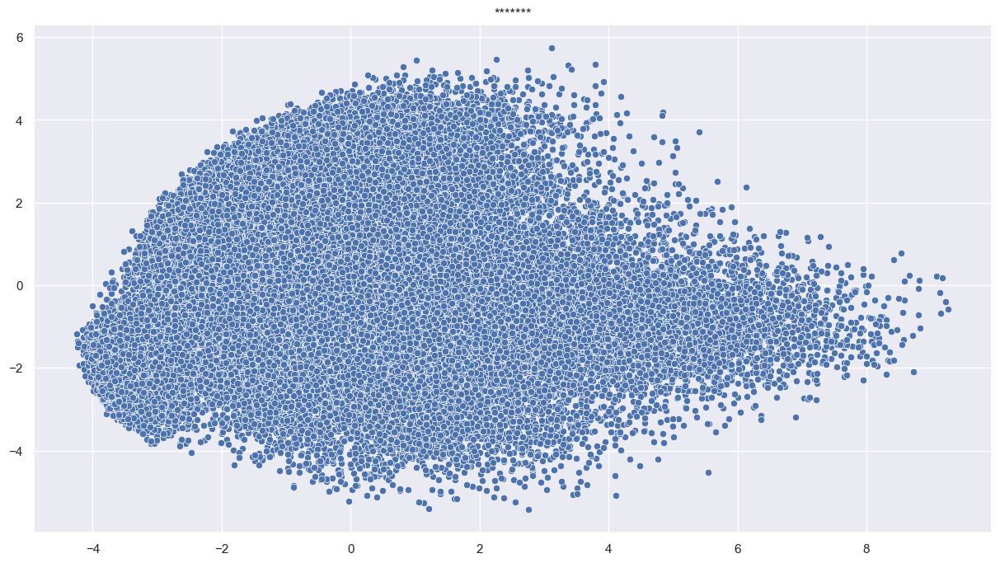

In [60]:
make_simple_2D_plot(X_train_PCA_2)

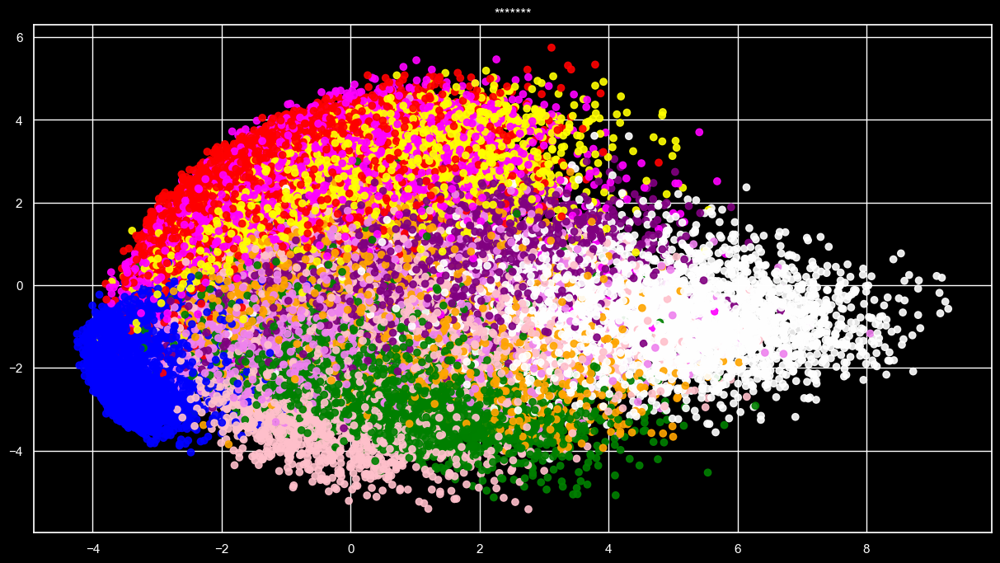

In [61]:
make_2D_plot(X_train_df_PCA_2)

# Вид датасета в трёх координатах, снижение размерности произведено с помошью РСА

In [62]:
X_train_PCA_3 = make_PCA(X_train_df, n=3)

In [63]:
make_3D_plot(X_train_PCA_3)

# Более продвинутый метод снижения размерности UMAP. вывод датасета в 2х координатаи и 3х координатах

In [47]:
X_train_UMAP_2 = make_UMAP(X_train_df)

[Text(0.5, 1.0, '*******')]

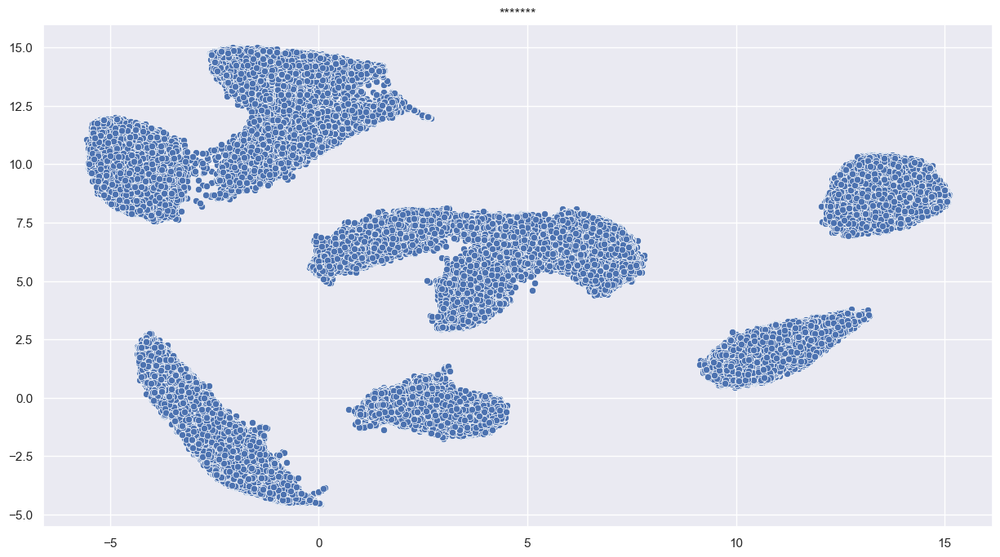

In [64]:
make_simple_2D_plot(X_train_UMAP_2)

In [50]:
X_train_df_UMAP_2 = pd.DataFrame(X_train_UMAP_2)

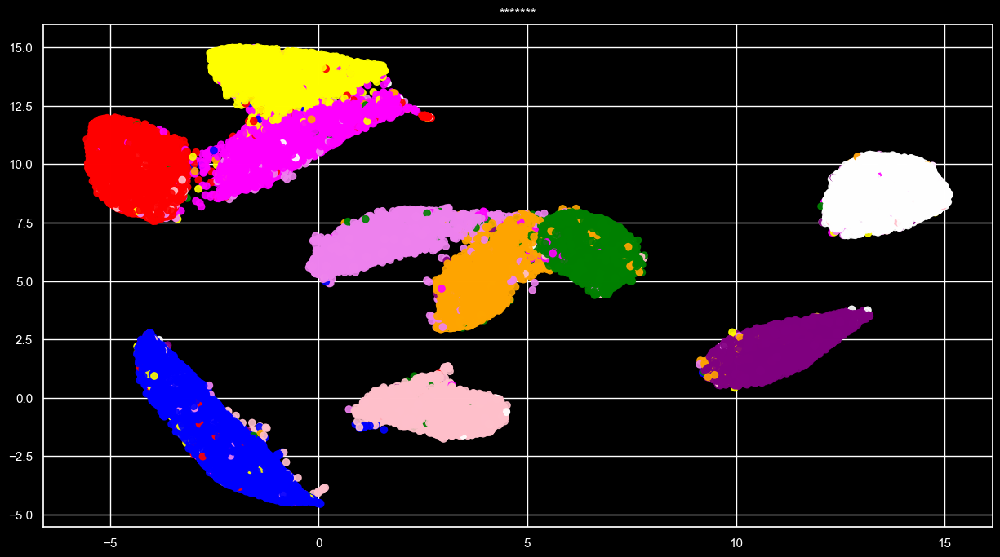

In [51]:
make_2D_plot(X_train_df_UMAP_2)

In [40]:
X_train_UMAP_3 = make_UMAP(X_train_df, n=3)

In [46]:
make_3D_plot(X_train_UMAP_3)